<a href="https://colab.research.google.com/github/Bashinim/Parking-Lot-Detection/blob/main/Detectron2/COWC_Instance_Segmentation_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instance Segmentation with COWC dataset. The annotations are in COCO format


In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 26kB/s 
     |████████████████████████████████| 6.6MB 55.3MB/s 
ERROR: torchtext 0.10.0 has requirement torch==1.9.0, but you'll have torch 1.5.0+cu101 which is incompatible.
  Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
     |████████████████████████████████| 276kB 8.1MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44091 sha256=4e95d8c0563a6c18562a3baf4c0ed168c579c5c145b31d79125b344b013c361a
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML

In [3]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.8)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#import torch
#assert torch.__version__.startswith("1.8")   # need to manually install torch 1.8 if Colab changes its default version
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 5.8MB/s 
     |████████████████████████████████| 51kB 4.3MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210624-cp37-none-any.whl size=60611 sha256=9da43c9d879276911adc32f86b9511a123cec58aae7b11c8e51f08c2845e2cfd
  Stored in directory: /root/.cache/pip/wheels/6d/3d/8b/911fda7dc70c40197710f00c0e0b6d0d11c4d0bfb620567894
Successfully built fvcore


## Get data

In [4]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

Importing data

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/train")
#register_coco_instances("my_dataset_valid", {}, "/content/drive/MyDrive/COWC in COCO format/valid/annotations_valid.json", "/content/drive/MyDrive/COWC in COCO format/valid")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json", "/content/drive/MyDrive/Cowc for detectrone2 test/test")

## Register data-set

In order to use a dataset with Detectron2 we need to register it. For more information check out the official documentation.

WARNING [06/26 08:53:46 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 08:53:46 d2.data.datasets.coco]: Loaded 71 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Train_annotations.json


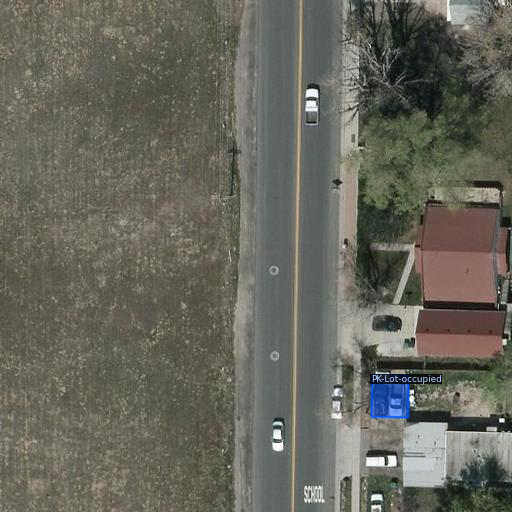

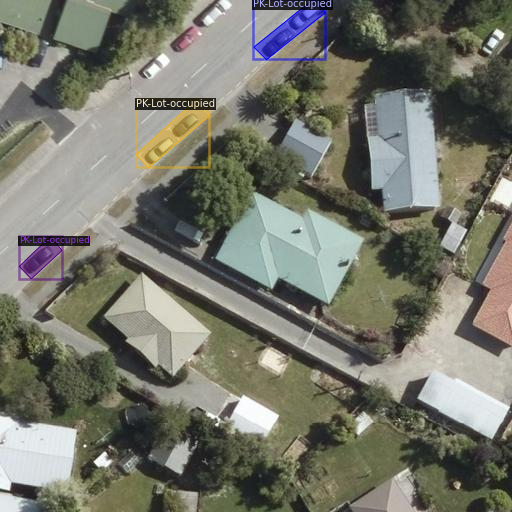

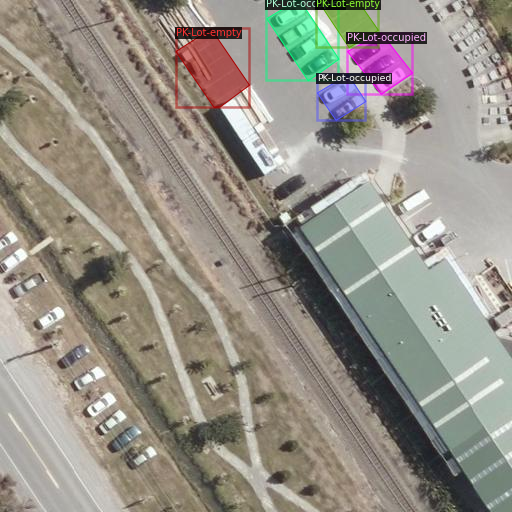

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## Train model

Now, let's fine-tune a pretrained FasterRCNN instance segmentation model on the microcontroller data-set.

In [7]:
%%javascript
function ClickConnect(){
console.log("Working");
document.querySelector("colab-toolbar-button#connect").click()
}setInterval(ClickConnect,60000)

<IPython.core.display.Javascript object>

In [8]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.MAX_ITER = 700
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[06/26 08:54:04 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:01, 93.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to

[06/26 08:54:07 d2.engine.train_loop]: Starting training from iteration 0
[06/26 08:54:16 d2.utils.events]:  eta: 0:04:20  iter: 19  total_loss: 2.571  loss_cls: 1.413  loss_box_reg: 0.154  loss_mask: 0.695  loss_rpn_cls: 0.303  loss_rpn_loc: 0.041  time: 0.4032  data_time: 0.1297  lr: 0.000050  max_mem: 2564M
[06/26 08:54:23 d2.utils.events]:  eta: 0:04:06  iter: 39  total_loss: 1.786  loss_cls: 0.630  loss_box_reg: 0.162  loss_mask: 0.684  loss_rpn_cls: 0.173  loss_rpn_loc: 0.043  time: 0.3813  data_time: 0.0155  lr: 0.000100  max_mem: 2564M
[06/26 08:54:31 d2.utils.events]:  eta: 0:03:59  iter: 59  total_loss: 1.500  loss_cls: 0.400  loss_box_reg: 0.272  loss_mask: 0.654  loss_rpn_cls: 0.137  loss_rpn_loc: 0.042  time: 0.3805  data_time: 0.0062  lr: 0.000150  max_mem: 2564M
[06/26 08:54:38 d2.utils.events]:  eta: 0:03:51  iter: 79  total_loss: 1.313  loss_cls: 0.314  loss_box_reg: 0.231  loss_mask: 0.631  loss_rpn_cls: 0.105  loss_rpn_loc: 0.032  time: 0.3771  data_time: 0.0045  lr:

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Use model for inference

Now, we can perform inference on our validation set by creating a predictor object.

In [10]:
# DatasetCatalog.clear()
# MetadataCatalog.clear()

In [11]:
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
# cfg.DATASETS.TEST = ("my_dataset_test", )
# predictor = DefaultPredictor(cfg)

In [12]:
#test evaluation
test_metadata = MetadataCatalog.get("my_dataset_test")
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [06/26 08:59:23 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 08:59:23 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json
[06/26 08:59:23 d2.data.build]: Distribution of instances among all 2 categories:
|   category   | #instances   |   category    | #instances   |
|:------------:|:-------------|:-------------:|:-------------|
| PK-Lot-empty | 77           | PK-Lot-occu.. | 62           |
|              |              |               |              |
|    total     | 139          |               |              |
[06/26 08:59:23 d2.data.common]: Serializing 31 elements to byte tensors and concatenating them all ...
[06/26 08:59:23 d2.data.common]: Serialized dataset takes 0.03 MiB
[06/26 08:59:23 d2.evaluation.evaluator]: Start inference on 31 images
[06/26 08:59:28 d2.evaluation.evaluator]: Inference done 11/31. 0.0826 s / 

OrderedDict([('bbox',
              {'AP': 33.33297625637055,
               'AP-PK-Lot-empty': 33.84024468626146,
               'AP-PK-Lot-occupied': 32.82570782647964,
               'AP50': 59.28049724673803,
               'AP75': 33.34906439531753,
               'APl': 52.734376714982425,
               'APm': 34.45074170821788,
               'APs': 26.329007488400276}),
             ('segm',
              {'AP': 31.19566351797094,
               'AP-PK-Lot-empty': 31.927207283113855,
               'AP-PK-Lot-occupied': 30.46411975282802,
               'AP50': 57.99814569150692,
               'AP75': 30.364653247625046,
               'APl': 59.780038443404784,
               'APm': 31.763541140799507,
               'APs': 16.528936636961806})])

WARNING [06/26 08:59:33 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 08:59:33 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/Cowc for detectrone2 test/Test_annotations.json


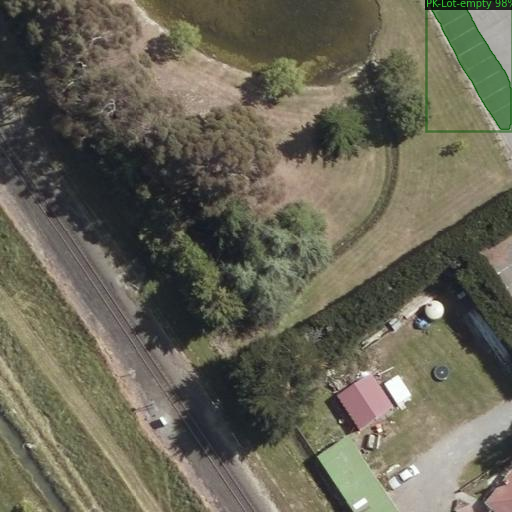

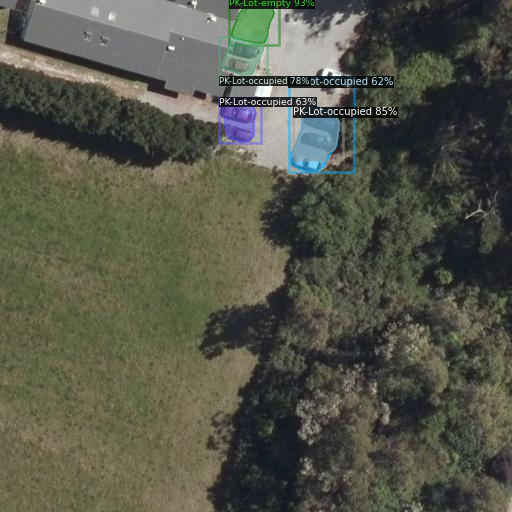

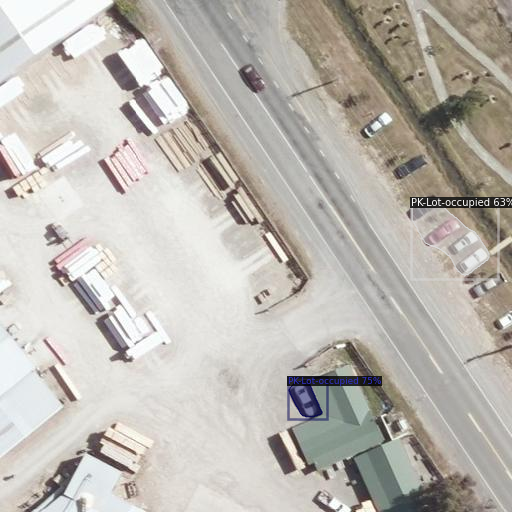

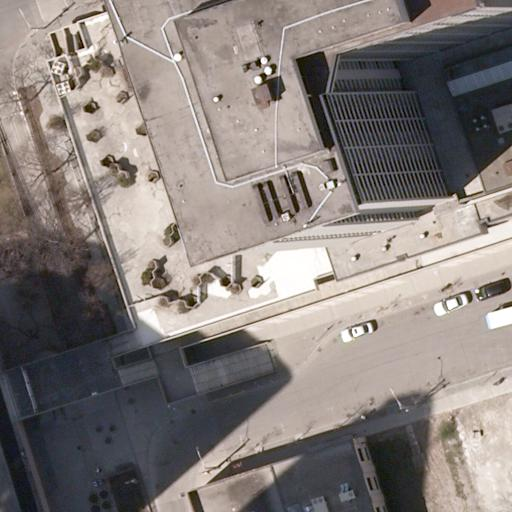

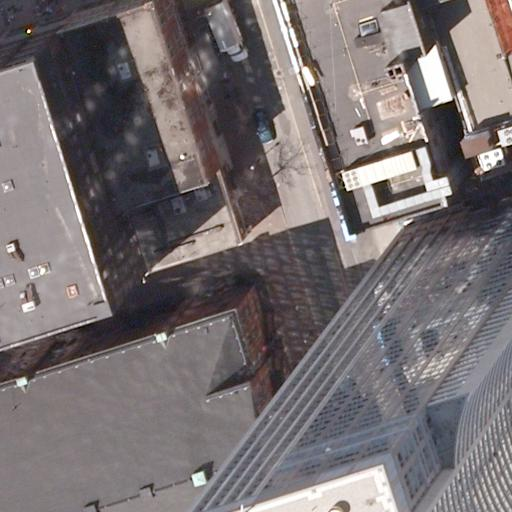

...

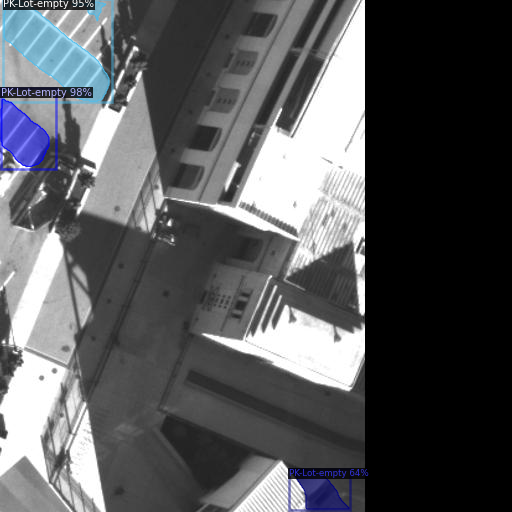

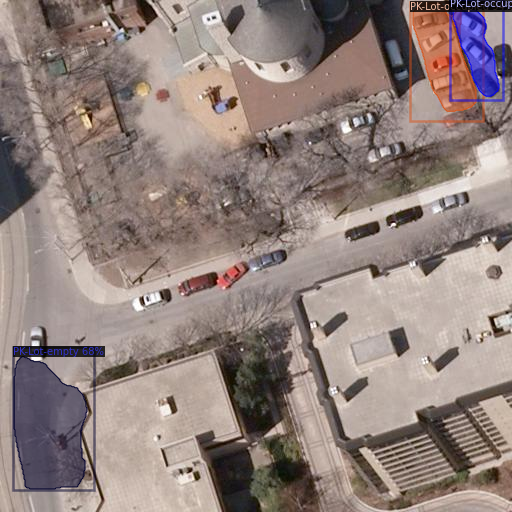

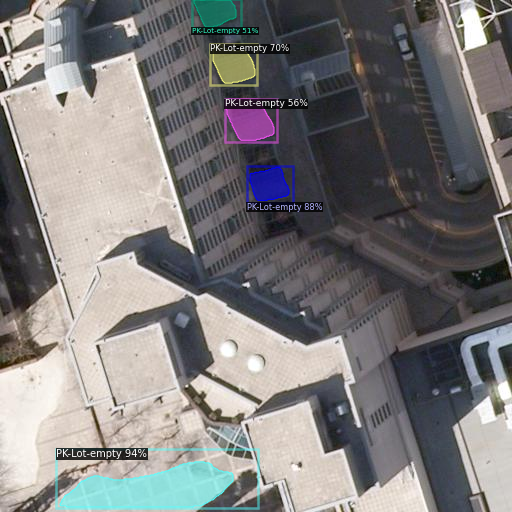

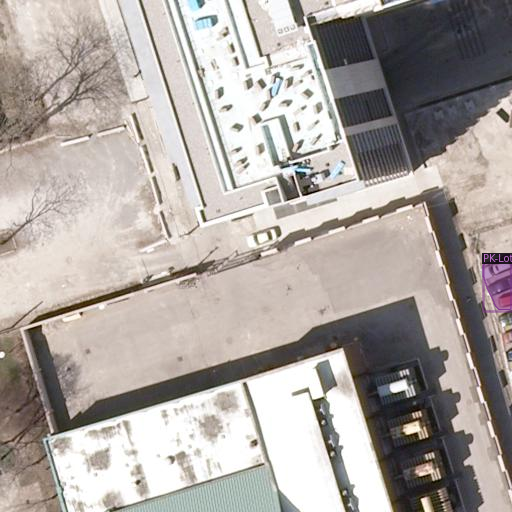

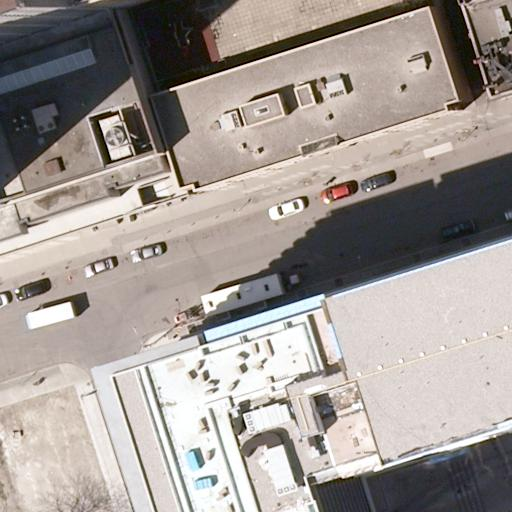

In [13]:

from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("my_dataset_test")
for d in random.sample(dataset_dicts, 20):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=test_metadata, 
                   scale=1, 
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [14]:
# Printing the names of the categories
for i, name in enumerate(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes):
    print(i, name)

0 PK-Lot-empty
1 PK-Lot-occupied


In [3]:
# from detectron2.utils.visualizer import ColorMode
import glob
import json
import numpy as np
from pycocotools import mask
from skimage import measure
import base64
import cv2

for imageName in glob.glob('/content/drive/MyDrive/Cowc for detectrone2 test/test/*.jpg'):
#for d in dataset_dicts:
  im = cv2.imread(imageName)
  outputs = predictor(im)
  masks = outputs['instances'].pred_masks.cpu().numpy()
  categories = outputs['instances'].pred_classes.cpu().numpy()
  encoded = base64.b64encode(open(imageName, "rb").read())
  print(encoded)
  number_of_masks = masks.shape[0]
  file_name_1 = imageName.replace("/content/drive/MyDrive/Cowc for detectrone2 test/test/","")
  file_name_2 = file_name_1.replace(".jpg","")
  file_name_3 = file_name_2 + ".json"
  
  main_annotation = {}
  main_annotation['shapes'] = []


  # Iterating for all masks. Every mask has one contour and a category relevant for that
  for x in range(0, number_of_masks):
    # Selecting relevant mask. Number of masks == number of categories
    ground_truth_binary_mask = masks[x,:,:]
    category = categories[x]
    if category == 0:
      cat = "PK-Lot-empty"
    else:
      cat = "PK-Lot-occupied"
    #fortran_ground_truth_binary_mask = np.asfortranarray(ground_truth_binary_mask)
    contours = measure.find_contours(ground_truth_binary_mask, 0)

    cont_s, _ = cv2.findContours(ground_truth_binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    polys = []
    for object in cont_s:
      coords = []
      for point in object:
        coords.append(int(point[0][0]))
        coords.append(int(point[0][1]))
        polys.append(coords)
      print(polys)
    # for contour in contours:
    # contour = np.flip(contours, axis=1)
    # segmentation = contour.reshape((len(contour.ravel())//2),2).tolist()
    # print(contours)
    # print(np.array(contours).shape)

    annotation = {
          "label" : cat,
          "points": np.flip(contours[0], axis=1).tolist(),
          "group_id": None,
          "shape_type": "polygon",
          "flags": {}}

    main_annotation['shapes'].append(annotation)

  main_annotation["imagePath"] = file_name_1
  main_annotation["imageData"] = str(encoded)[2:-1]
  main_annotation["imageHeight"] = 512
  main_annotation["imageWidth"] = 512
  print(main_annotation)
  # print(json.dumps(annotation, indent=4,  separators=(',', ':',)))
  with open(file_name_3, 'w') as file:
    json.dump(main_annotation, file,indent=4,  separators=(',', ':',))

  # v = Visualizer(im[:, :, ::-1],
  #                 metadata=test_metadata, 
  #                 scale=1, 
  #                 #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
  # )
  # v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  # cv2_imshow(v.get_image()[:, :, ::-1])

  # f = open("/content/drive/MyDrive/Cowc for detectrone2 test/COWC_PKLot_Predictions.txt","a")
  # f.write(str(d["file_name"]) +"\n" + str(outputs["instances"])+"\n")
  # f.close()
  break
  break